In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

The data is county data from 2015 that includes education levels, percent of population in different job industries, types of transportation used

In [22]:
data = pd.read_csv('merged data.csv')

In [23]:
data.head()

,Unnamed: 0,County,State,Female high school graduate or higher,Female Percent bachelor's degree or higher,Male Percent high school graduate or higher,Male Percent bachelor's degree or higher,Total Percent high school graduate or higher,Total Percent bachelor's degree or higher,States,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
0,0,Baldwin,Alabama,0.921,0.314,0.894,0.275,0.908,0.295,Alabama,...,1.0,1.4,3.9,26.4,85953,81.5,12.3,5.8,0.4,7.5
1,1,Calhoun,Alabama,0.824,0.173,0.816,0.173,0.820,0.173,Alabama,...,1.2,1.2,2.7,24.1,47401,74.1,20.8,5.0,0.1,12.3
2,2,Cullman,Alabama,0.810,0.121,0.840,0.135,0.825,0.128,Alabama,...,1.5,1.0,2.6,26.4,32282,81.6,12.2,5.8,0.4,7.3
3,3,DeKalb,Alabama,0.716,0.110,0.668,0.090,0.693,0.100,Alabama,...,0.6,0.9,2.1,22.8,27778,78.8,12.6,8.5,0.1,7.7
4,4,Elmore,Alabama,0.881,0.209,0.793,0.206,0.840,0.207,Alabama,...,0.4,1.2,2.2,28.5,33636,70.4,24.1,5.5,0.0,8.3


In [24]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 802 entries, 0 to 801
Data columns (total 45 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Unnamed: 0                                    802 non-null    int64  
 1   County                                        802 non-null    object 
 2   State                                         802 non-null    object 
 3   Female high school graduate or higher         802 non-null    float64
 4   Female Percent bachelor's degree or higher    802 non-null    float64
 5   Male Percent high school graduate or higher   802 non-null    float64
 6   Male Percent bachelor's degree or higher      802 non-null    float64
 7   Total Percent high school graduate or higher  802 non-null    float64
 8   Total Percent bachelor's degree or higher     802 non-null    float64
 9   States                                        802 non-null    obj

Drop some columns we know we're not going to be using

In [27]:
data = data.drop(columns = ['Unnamed: 0', 'States', 'CensusId', 'IncomeErr', 'IncomePerCapErr'])


This is a data set taht has multiple features we could look at as our primary feature. Income, specifically income per capita, is a popular feature that is often analyzed looking for correlating ways to maximize it. Poverty is another feature that is popular looking for ways to minimize it. 

In [61]:
data['IncomePerCap'].describe()

count      802.000000
mean     27759.528678
std       6586.052073
min      12614.000000
25%      23500.750000
50%      26470.500000
75%      30687.250000
max      64993.000000
Name: IncomePerCap, dtype: float64

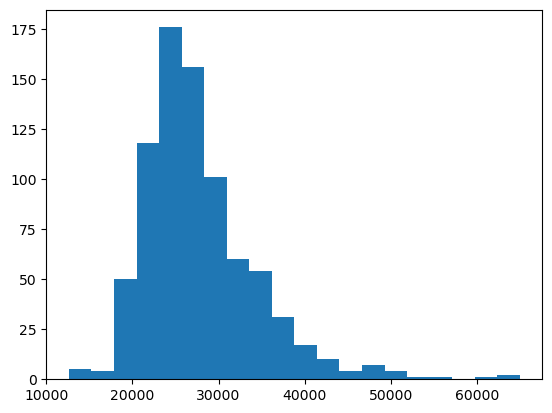

In [60]:
histo = plt.hist(data['IncomePerCap'], bins = 20)

Lets take a quick look at income data based on states.

In [156]:
state_data = data.groupby(by='State')['IncomePerCap'].describe()
state_data

,count,mean,std,min,25%,50%,75%,max
State,,,,,,,,
Alabama,21.0,24035.857143,3775.169762,18411.0,21363.00,24168.0,25138.00,33494.0
Alaska,3.0,33359.000000,3504.915263,29913.0,31578.50,33244.0,35082.00,36920.0
Arizona,10.0,21749.600000,4570.224702,13011.0,19570.00,22318.0,25140.50,27832.0
Arkansas,11.0,24296.636364,2323.222171,19885.0,23136.50,24070.0,25344.00,27934.0
California,40.0,29233.550000,9853.175432,16143.0,21793.25,27715.5,34380.50,60236.0
Colorado,12.0,32724.583333,7010.769371,22191.0,26705.50,32747.0,37567.25,45500.0
Connecticut,8.0,37025.125000,6558.030550,28140.0,33869.00,35528.5,39216.75,50137.0
Delaware,3.0,28952.000000,3760.512199,25404.0,26981.00,28558.0,30726.00,32894.0
District of Columbia,1.0,47675.000000,NaN,47675.0,47675.00,47675.0,47675.00,47675.0


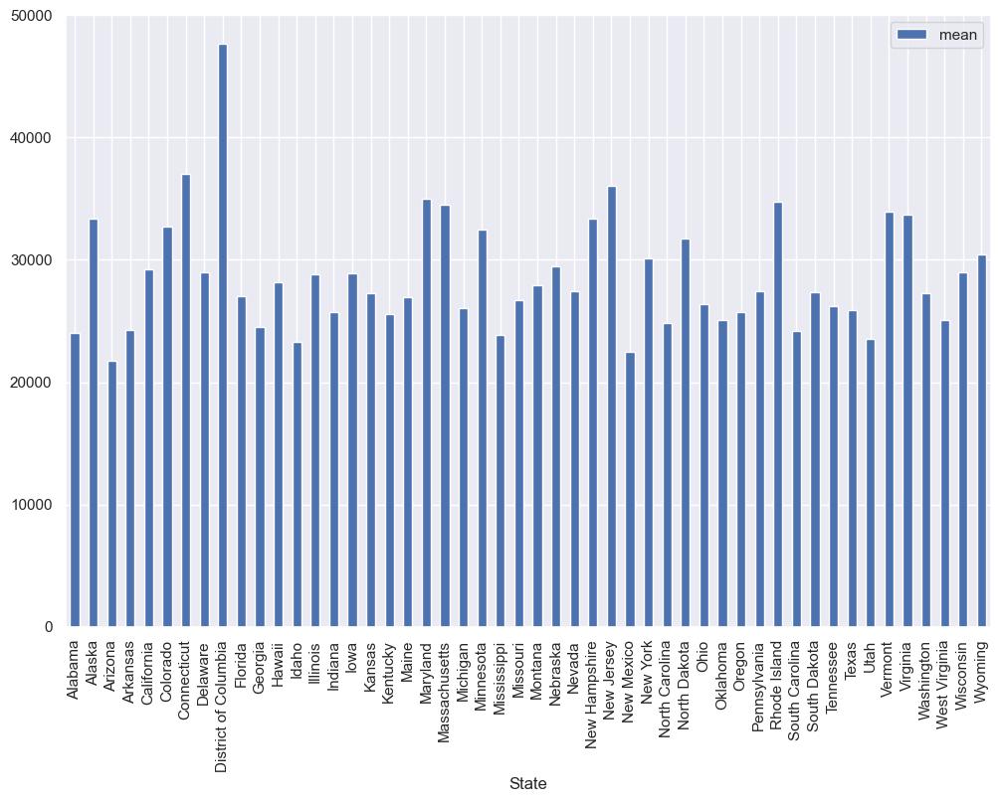

In [157]:
statehist = state_data.plot.bar(y='mean', figsize=(12,8))

In [158]:
state_data = data.groupby(by='State')['Total Percent bachelor\'s degree or higher'].describe()
state_data

,count,mean,std,min,25%,50%,75%,max
State,,,,,,,,
Alabama,21.0,0.232524,0.094010,0.094,0.16800,0.2220,0.31000,0.414
Alaska,3.0,0.301000,0.085913,0.202,0.27350,0.3450,0.35050,0.356
Arizona,10.0,0.214700,0.080759,0.119,0.15475,0.1865,0.29575,0.331
Arkansas,11.0,0.248091,0.068503,0.147,0.19050,0.2500,0.31900,0.339
California,40.0,0.290575,0.121601,0.125,0.18200,0.2870,0.36950,0.589
Colorado,12.0,0.406083,0.134120,0.216,0.29200,0.4210,0.49350,0.606
Connecticut,8.0,0.364125,0.065582,0.246,0.33475,0.3585,0.40650,0.463
Delaware,3.0,0.277667,0.073759,0.213,0.23750,0.2620,0.31000,0.358
District of Columbia,1.0,0.567000,NaN,0.567,0.56700,0.5670,0.56700,0.567


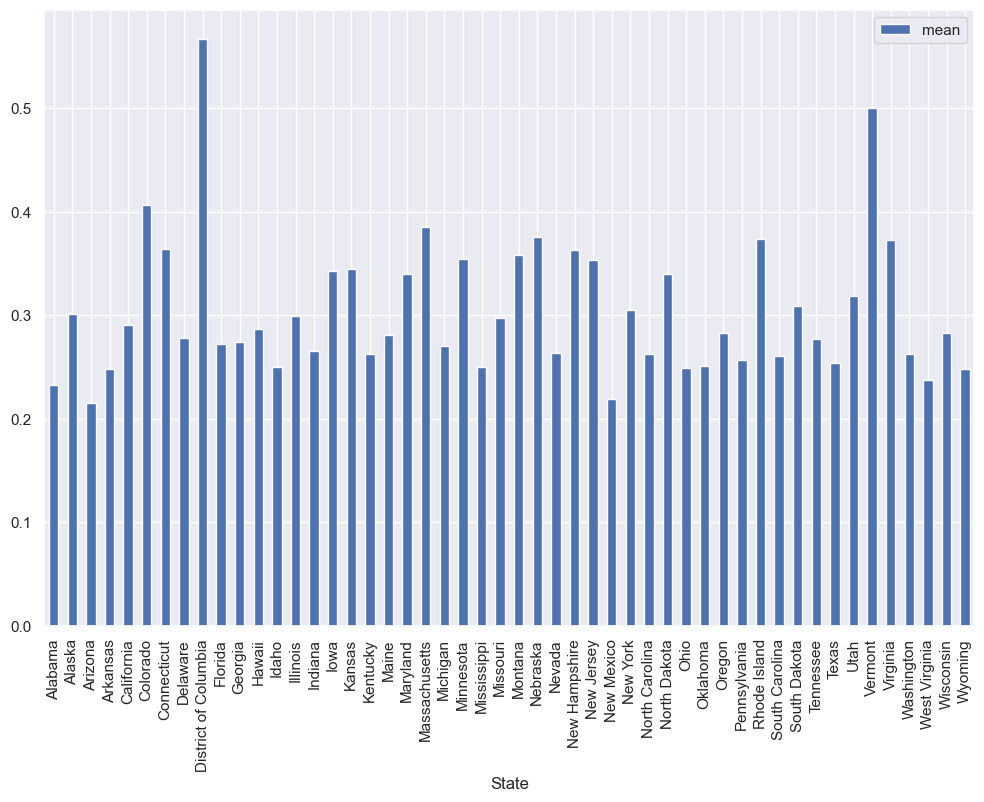

In [159]:
statehist = state_data.plot.bar(y='mean', figsize=(12,8))

The state data shows that the states are varied but the means for income are contained within a range from \\$43683 to \\$74125. The top end of the range is alask with only 3 counties accounted for in the data and the bottom end is Arizone with 10 countiesa accounted for. Income Per Capita has a minimum value of \\$21749, from Arizone, and a maximum value of $47675, from the District of Columbia. Alaska who had the highest mean income does not have the highest average income per capita but is still high on the list. Education levels are varied with places like the District of Columbia and Vermont having very high rates of bachelor degrees among their populations. Those states both only have one county in them and are skewed by there only being one data point per state. Without more specific state and county data like government spending and average cost of living we can focus on the total data without picking out the differences from state to state for overarching themes.

In [91]:
#Lets take a look at the correlation data for the entire dataset.
correlations = data.corr()


pandas.core.frame.DataFrame

In [104]:
ipc = correlations['IncomePerCap'].to_numpy()
print(type(ipc))
#Sort the array. Sorts in ascending order.
ipc.sort
#reverse the order of the aray.
ipc = np.flipud(ipc)
#Remove index 0 which is the index of the correlation for IndexPerCap to itself
ipc = np.delete(ipc, 0)
ipc

<class 'numpy.ndarray'>


array([ 0.88119624,  0.82523154,  0.81528309,  0.80612929,  0.80578104,
        0.54229883,  0.54084947,  0.51449358,  0.44005636,  0.43741152,
        0.38181931,  0.36794255,  0.2390627 ,  0.21932298,  0.19906792,
        0.19803221,  0.19690252,  0.11806808,  0.09631538,  0.08413537,
        0.0786242 ,  0.07042815,  0.00882001, -0.0928771 , -0.10690794,
       -0.11398017, -0.13763333, -0.14672725, -0.17072209, -0.30946874,
       -0.40082237, -0.47577742, -0.4799173 , -0.4970127 , -0.58852147,
       -0.71141584, -0.71406362])

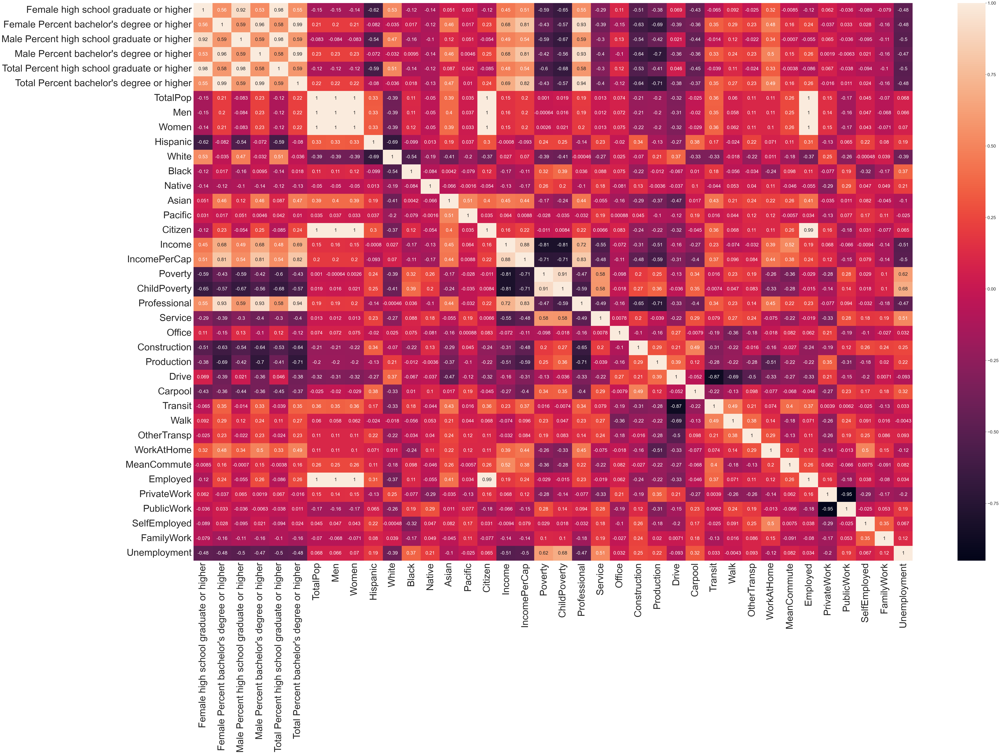

In [108]:
plt.figure(figsize=(80,50))
sns.set(font_scale=2)
ax = sns.heatmap(data.corr(), annot=True)
ax.set_yticklabels(ax.get_yticklabels(), size= 48);
ax.set_xticklabels(ax.get_xticklabels(), size=48);

Looking at the correlation data we can see that Income Per Capita correlates most with the education levels and the Professional job category. Looking closely at those features they also correlate to each other with bachelor degrees correlating most strongly with jobs that fall in the Professional category. Income Per Capita has strong negative correlations with most of the other job categories. The indication here appears to be that Professional jobs strongly pull up the average compared to the rest of the job categories.

In [119]:
plt.figure(figsize=(8,6))
sns.set(font_scale=1)
ax.set_yticklabels(ax.get_yticklabels(), size= 12);
ax.set_xticklabels(ax.get_xticklabels(), size= 12);
sns.pairplot(data)

<Figure size 800x600 with 0 Axes>

<Figure size 800x600 with 0 Axes>

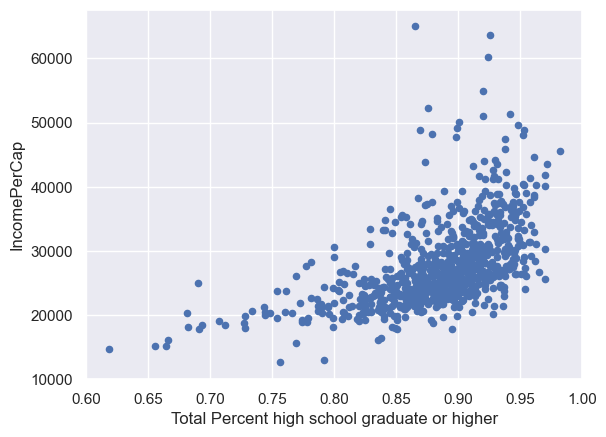

In [116]:

plot = data.plot.scatter(x = 'Total Percent high school graduate or higher', y = 'IncomePerCap')

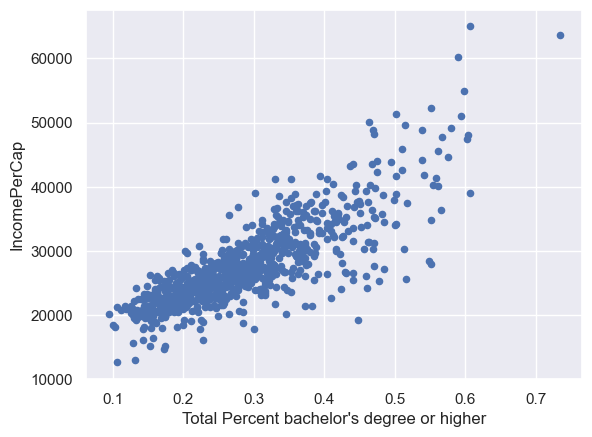

In [117]:
plot = data.plot.scatter(x = 'Total Percent bachelor\'s degree or higher', y = 'IncomePerCap',)

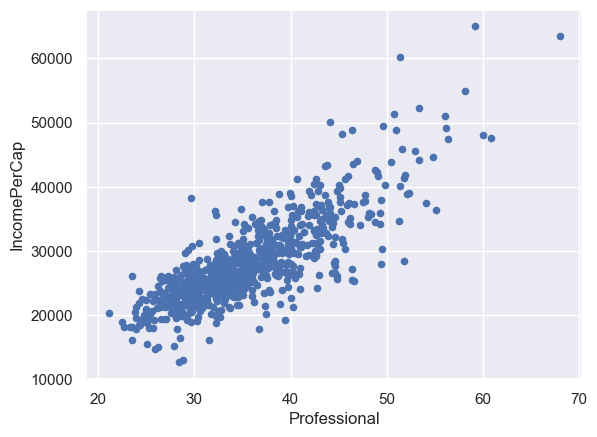

In [118]:

plot = data.plot.scatter(x = 'Professional', y = 'IncomePerCap')

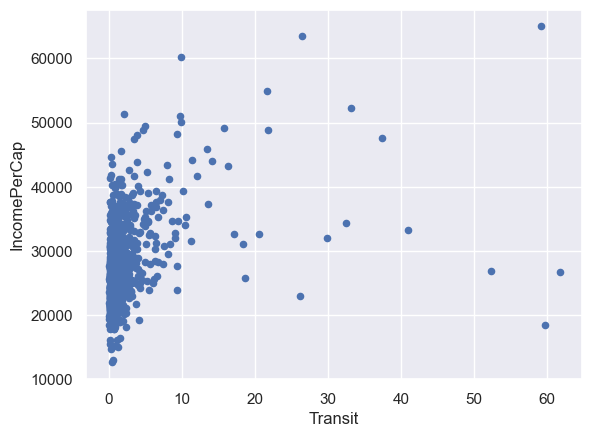

In [125]:
plot = data.plot.scatter(x = 'Transit', y = 'IncomePerCap')

We had also discussed poverty as a potential target feature. It correlates most with unemployment and service industry jobs. It also strongly correlates negatively with education showing at a glance that education does have a large impact on poverty levels in a region.

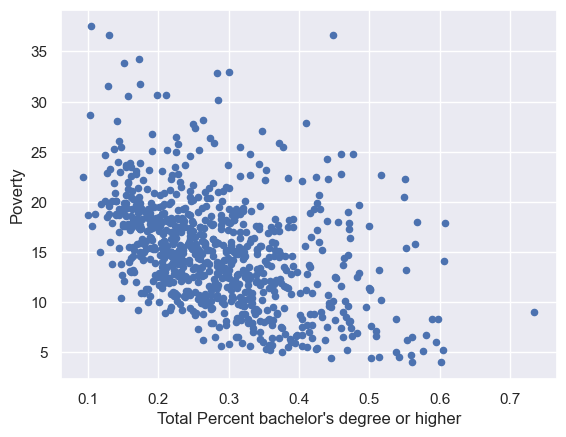

In [126]:
plot = data.plot.scatter(x = 'Total Percent bachelor\'s degree or higher', y = 'Poverty')

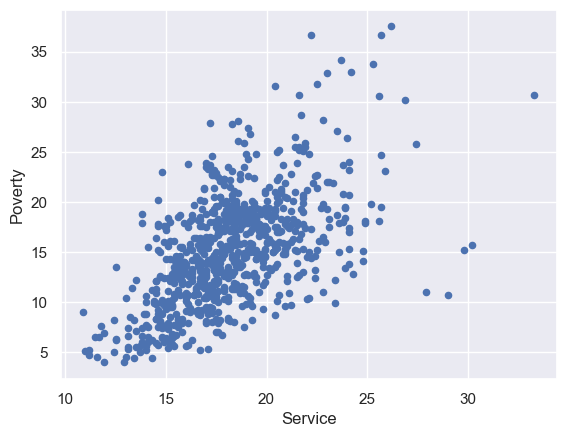

In [130]:
plot = data.plot.scatter(x = 'Service', y = 'Poverty')

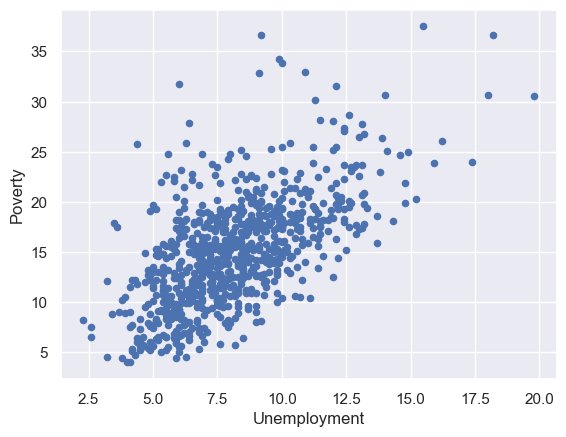

In [131]:
plot = data.plot.scatter(x = 'Unemployment', y = 'Poverty')